<a href="https://colab.research.google.com/github/wikiban43/Misinformation-Analysis/blob/main/Network_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Get the retweet graph and analyze influential nodes

In [132]:
import json
import requests
import os
import json
import time
import pandas as pd
from datetime import datetime,timedelta
import time
import pickle
from google.colab import drive
drive.mount('/content/drive')
import tweepy
consumer_key = "cDiClkP49iTsbc3G7Ti5VJcLp"
consumer_secret = "2d4sR9ypcH7bNYFrDN6qeHf3NpUGBfOwBwPK4kS3JGRwQTuD5B"
#Bearer = AAAAAAAAAAAAAAAAAAAAAD%2BcYgEAAAAAHw4G9h4lbyrz0Um6UPwmQuXMegI%3DMK7BwPEtDWySjj9XQnKxBZ5ek5BOurIy73soU7Ir2TxMo5TdO9
access_token = "2934858343-MoyJzYCbfgK7u356NwOOxRh9VShk2J8jCwkQTzK"
access_secret = "CW5gOfLeEQHs4El5UarVe3MGvDjMjXoTPYnn2vjXQIwN0"

# Authenticate Tweepy connection to Twitter API
auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)
api = tweepy.API(auth, wait_on_rate_limit=True)
#path = "drive/My Drive/MSR/ssr_keywords3/final tweets/"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [276]:
# Get the frequency, PDF and CDF for each value in the series
def get_cdf_data(df,col_name):
  # Frequency
  df = df.sort_values(col_name).reset_index()
  stats_df = df.groupby(col_name)[col_name].agg('count').pipe(pd.DataFrame).rename(columns = {col_name: 'frequency'})
  # PDF
  stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])
  # CDF
  stats_df['cdf'] = stats_df['pdf'].cumsum()
  stats_df = stats_df.reset_index()
  stats_df
  return stats_df

In [203]:
#Some preprocessing for budget data
path = "drive/My Drive/MSR/"#icwsm_datasets/old datasets/"
df1 = pd.read_csv(path+'budget2022_jan_mar.csv')
df2 = pd.read_csv(path+'budget2022_mar_jul.csv')
df = pd.concat([df1,df2])

In [204]:
df.shape

(846306, 11)

In [279]:
#df = pd.read_csv(path+"all_tweets.csv")

path = "drive/My Drive/MSR/icwsm_datasets/"
df = pd.read_csv(path+"caa_nrc.csv")
#df = pd.read_csv(path+"budget2022_jan_jul.csv")
#df = pd.read_csv(path+"budget2022_6months.csv")
#os.listdir(path)
df["created_at"].isna().sum()
#df.shape  

0

In [282]:
df.head()

,Unnamed: 0,created_at,text,id,referenced_tweets,author_id,entities.hashtags,entities.mentions,public_metrics.retweet_count,public_metrics.reply_count,...,author.id,author.name,author.username,entities.annotations,entities.urls,withheld.copyright,withheld.country_codes,withheld.scope,author.withheld.country_codes,author.withheld.scope
0,0,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238608816587116545,"[{'type': 'retweeted', 'id': '1238341583222607...",4602051741,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,4602051741,Ravi Naidu,Tintin007Uk,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2020-03-13,@AntiCAA_NPR @JM_Scindia BJP is not as rich as...,1238606586806820864,"[{'type': 'replied_to', 'id': '123847285477505...",4184994687,NaN,"[{'start': 13, 'end': 24, 'username': 'JM_Scin...",0,0,...,4184994687,Pradeep,Pradip_06,"[{'start': 25, 'end': 27, 'probability': 0.703...",NaN,NaN,NaN,NaN,NaN,NaN
2,2,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238603451367444481,"[{'type': 'retweeted', 'id': '1238341583222607...",57332267,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,57332267,J Hindu,Vandanainc,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238593999016873984,"[{'type': 'retweeted', 'id': '1238341583222607...",3999666303,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,3999666303,Alok Kumar,Alok4BJP,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238590610904354817,"[{'type': 'retweeted', 'id': '1238341583222607...",59214590,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,59214590,sandeep barot,sandeepbarot,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [283]:
from datetime import datetime
def get_date(string):
  try:
    date = datetime.strptime(string, '%Y-%m-%dT%H:%M:%S.%fZ')
  except:
    date = string
    return date
  #date = str(date.month)+"/"+str(date.year)
  return date.date()

def get_author_name(string):
  try:
    d = ast.literal_eval(string)
    return d["username"]
  except:
    return "None"

df["created_at"] = df["created_at"].apply(lambda x: get_date(x))
#df["author.username"] = df["author"].apply(lambda x: get_author_name(x))

In [281]:
df.head(10)

,Unnamed: 0,created_at,text,id,referenced_tweets,author_id,entities.hashtags,entities.mentions,public_metrics.retweet_count,public_metrics.reply_count,...,author.id,author.name,author.username,entities.annotations,entities.urls,withheld.copyright,withheld.country_codes,withheld.scope,author.withheld.country_codes,author.withheld.scope
0,0,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238608816587116545,"[{'type': 'retweeted', 'id': '1238341583222607...",4602051741,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,4602051741,Ravi Naidu,Tintin007Uk,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2020-03-13,@AntiCAA_NPR @JM_Scindia BJP is not as rich as...,1238606586806820864,"[{'type': 'replied_to', 'id': '123847285477505...",4184994687,NaN,"[{'start': 13, 'end': 24, 'username': 'JM_Scin...",0,0,...,4184994687,Pradeep,Pradip_06,"[{'start': 25, 'end': 27, 'probability': 0.703...",NaN,NaN,NaN,NaN,NaN,NaN
2,2,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238603451367444481,"[{'type': 'retweeted', 'id': '1238341583222607...",57332267,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,57332267,J Hindu,Vandanainc,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238593999016873984,"[{'type': 'retweeted', 'id': '1238341583222607...",3999666303,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,3999666303,Alok Kumar,Alok4BJP,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238590610904354817,"[{'type': 'retweeted', 'id': '1238341583222607...",59214590,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,59214590,sandeep barot,sandeepbarot,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,5,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238584425098539008,"[{'type': 'retweeted', 'id': '1238341583222607...",2440465592,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,2440465592,Manish Rathore,ManishAtru,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,6,2020-03-13,@AntiCAA_NPR can not get help from kejriwaal s...,1238576937850863619,"[{'type': 'replied_to', 'id': '123842143017946...",954822462994288646,NaN,NaN,0,0,...,954822462994288646,gopal sanchiher,sanchiherg,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,7,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238568182194909184,"[{'type': 'retweeted', 'id': '1238341583222607...",2456941532,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,2456941532,Gautam Kotwal 🇮🇳,gautamkotwal81,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,8,2020-03-13,RT @RatanSharda55: Where are shameless #AntiCA...,1238566125774024705,"[{'type': 'retweeted', 'id': '1238341583222607...",151147238,"[{'start': 39, 'end': 47, 'tag': 'AntiCAA'}]","[{'start': 3, 'end': 17, 'username': 'RatanSha...",537,0,...,151147238,Shravan,MShravank,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,9,2020-03-13,@AntiCAA_NPR @JM_Scindia https://t.co/O0Uw7CpmW1,1238564286013702144,"[{'type': 'replied_to', 'id': '123847285477505...",801962894107627520,NaN,"[{'start': 13, 'end': 24, 'username': 'JM_Scin...",0,0,...,801962894107627520,Brave Indian,India4Lion,NaN,"[{'start': 25, 'end': 48, 'url': 'https://t.co...",NaN,NaN,NaN,NaN,NaN


In [284]:
df = df.sort_values(by="created_at").reset_index()

In [285]:
df["created_at"] = df["created_at"].astype(str)

In [287]:
df.head()

,index,Unnamed: 0,created_at,text,id,referenced_tweets,author_id,entities.hashtags,entities.mentions,public_metrics.retweet_count,...,author.id,author.name,author.username,entities.annotations,entities.urls,withheld.copyright,withheld.country_codes,withheld.scope,author.withheld.country_codes,author.withheld.scope
0,104198,104198,2019-12-13,Modi and Amit you are responsible for present ...,1205438278339444736,NaN,1072132722347261952,"[{'start': 228, 'end': 234, 'tag': 'nocaa'}, {...",NaN,4,...,1072132722347261952,Ankur Bordoloi,AnkurBo24271473,"[{'start': 0, 'end': 3, 'probability': 0.8899,...",NaN,NaN,NaN,NaN,NaN,NaN
1,104197,104197,2019-12-13,RT @AnkurBo24271473: Modi and Amit you are res...,1205450127139201024,"[{'type': 'retweeted', 'id': '1205438278339444...",1204474594372907008,NaN,"[{'start': 3, 'end': 19, 'username': 'AnkurBo2...",4,...,1204474594372907008,AMLAN BORDOLOI,AMLANBORDOLOI3,"[{'start': 21, 'end': 24, 'probability': 0.918...",NaN,NaN,NaN,NaN,NaN,NaN
2,104196,104196,2019-12-13,RT @AnkurBo24271473: Modi and Amit you are res...,1205450926724648960,"[{'type': 'retweeted', 'id': '1205438278339444...",1205438327026941952,NaN,"[{'start': 3, 'end': 19, 'username': 'AnkurBo2...",4,...,1205438327026941952,Vinod Sharma,VinodSh53899845,"[{'start': 21, 'end': 24, 'probability': 0.918...",NaN,NaN,NaN,NaN,NaN,NaN
3,104195,104195,2019-12-13,RT @AnkurBo24271473: Modi and Amit you are res...,1205451607145500674,"[{'type': 'retweeted', 'id': '1205438278339444...",419529688,NaN,"[{'start': 3, 'end': 19, 'username': 'AnkurBo2...",4,...,419529688,Sanjib Maurya,MauryaSanjib,"[{'start': 21, 'end': 24, 'probability': 0.918...",NaN,NaN,NaN,NaN,NaN,NaN
4,104194,104194,2019-12-13,Anti-CAA protesters torch railway stations in ...,1205497752270057473,NaN,130501124,"[{'start': 53, 'end': 61, 'tag': 'AntiCAA'}, {...",NaN,0,...,130501124,#Rajanna(G🌐pi AdusuⓂilli),agk4444,"[{'start': 46, 'end': 51, 'probability': 0.941...","[{'start': 85, 'end': 108, 'url': 'https://t.c...",NaN,NaN,NaN,NaN,NaN


In [288]:
df["author.username"].nunique()

52673

In [289]:
#Divide the df into partitions based on date (budget)
'''
df_part1 = df.query("created_at >= '2022-01-01' and created_at < '2022-02-01'")
df_part2 = df.query("created_at >= '2022-01-01' and created_at < '2022-03-01'")
df_part3 = df.query("created_at >= '2022-01-01' and created_at < '2022-04-01'")
df_part4 = df.query("created_at >= '2022-01-01' and created_at < '2022-05-01'")
df_part5 = df.query("created_at >= '2022-01-01' and created_at < '2022-06-01'")
df_part6 = df.query("created_at >= '2022-01-01' and created_at < '2022-07-01'")
'''
#Divide the df into partitions based on date (CAA)
df_part1 = df.query("created_at >= '2019-12-01' and created_at < '2020-01-01'")
df_part2 = df.query("created_at >= '2019-12-01' and created_at < '2020-02-01'")
df_part3 = df.query("created_at >= '2019-12-01' and created_at < '2020-03-01'")
df_part4 = df.query("created_at >= '2019-12-01' and created_at < '2020-04-01'")


df_list = [df_part1,df_part2,df_part3,df_part4]#,df_part5,df_part6]

In [213]:
df_part5.shape

(804144, 13)

In [80]:
#import ast
#d = ast.literal_eval(str(df_part1["author"][0]))
#d["username"]

In [293]:
#Get indegree, outdegree, and eigen centrality values of network over time
import os
import json
import pandas as pd
import networkx as nx
from matplotlib import pyplot as plt
from wordcloud import WordCloud
from tqdm import tqdm
  

def get_retweeted_user(text):
    text_l = text.split(" ")
    if text_l[0]=="RT":
      target_uname = text_l[1].replace("@","")
      target_uname = target_uname.rstrip(":")
      #print("Target:"+target_uname)
      return target_uname

def draw(df_top):
  data = dict(zip(df_top['index'].tolist(), df_top['indegree centrality'].tolist()))
  # method 2: convert to dict
  data = df_top.set_index('index').to_dict()['indegree centrality']
  wc = WordCloud(width=800, height=400, max_words=200).generate_from_frequencies(data)
  plt.figure(figsize=(10, 10))
  plt.imshow(wc, interpolation='bilinear')
  plt.axis('off')
  plt.show()

#top_users=set()
df_final = pd.DataFrame()
for df in df_list:#[df_part1,df_part2,df_part3,df_part4]:
  print(df.shape)
  #Code for new file generated by Soham
  username_l = list(df["author.username"].unique())
  #Get the retweeted users
  if "text" in df.columns:
    df["retweeted user"] = df["text"].apply(lambda x: get_retweeted_user(x))

  #Get all retweet edges using Soham's data (A,B would mean A retweets B)
  #edges = []

  df['edges'] = list(zip(df["author.username"], df["retweeted user"]))
  edges = df['edges'].unique()
  #print(edges)
  print("COMPLETE")
  #Get the RT network between core users (one edge only between a pair of users even if there are multiple RTs between them)
  # generate generic network graph instance
  nx_graph = nx.DiGraph()
  for edge in edges:#[0:1000]:
    #print(edges_dict[edge])
    try:
      nx_graph.add_edge(edge[0],edge[1])
    except:
      continue
  #nx.draw(nx_graph, with_labels=True, node_size=10, alpha=1, linewidths=4)
  #plt.show()

  

  density = nx.density(nx_graph)
  print(density)
  #user = "nilotpalm3"
  #user = "ApurvaU21"

  #user_l = list(df["user"].unique())
  eig_centrality = nx.eigenvector_centrality_numpy(nx_graph)
  ind_centrality = nx.in_degree_centrality(nx_graph)
  out_centrality = nx.out_degree_centrality(nx_graph)

  user2cent = dict()

  #Initialize dict by indegree, outdegree, and eigen
  for edge in edges:
    u1 = edge[0]
    u2 = edge[1]
    user2cent[u1] = [0,0,0,0,0]
    user2cent[u2] = [0,0,0,0,0]


  #Storing indegree, outdegree, and eigen for each user (repetitions are counted separately -- no duplicate edge removal)
  for edge in edges:
    u1 = edge[0]
    u2 = edge[1]
    try:
      #Update for first user (indegree)
      if u1 not in user2cent:
        user2cent[u1][1] = 1
      #Enable if you want to capture duplicate edges
      else:
        user2cent[u1][1] += 1
      
      #Update for second user (outdegree)
      if u2 not in user2cent:
        user2cent[u2][0] = 1
      #Enable if you want to capture duplicate edges
      else:
        user2cent[u2][0] += 1

      
      #Update centralities
      user2cent[u1][2] = eig_centrality[u1]
      user2cent[u2][2] = eig_centrality[u2]

      user2cent[u1][3] = ind_centrality[u1]
      user2cent[u2][3] = ind_centrality[u2]

      user2cent[u1][4] = out_centrality[u1]
      user2cent[u2][4] = out_centrality[u2]
    except:
      continue


  
  df_cent = pd.DataFrame(user2cent).transpose()
  df_cent["in2out"] = (df_cent[0]/df_cent[1])
  df_cent = df_cent.sort_values([2],ascending=False).reset_index()
  df_cent.rename(columns={0:"indegree",1:"outdegree",2:"eigenvector centrality",3:"indegree centrality",4:"outdegree centrality"},inplace=True)
  #print(df_cent.nlargest(n=10, columns=['indegree']))
  #print(df_cent.head())
  df_top = df_cent.nlargest(n=30, columns=['indegree centrality']).reset_index()
  
  #draw(df_top)
  #print(df_top)
  if df_final.shape[0]>0:
    print("$$$")
    #top_users = top_users.intersection(set(df_cent.nlargest(n=10, columns=['indegree'])["index"].unique()))
    df_final = df_final.merge(df_top,on="index",how="inner")
  else:
    #top_users = set(df_cent.nlargest(n=10, columns=['indegree'])["index"].unique())
    df_final = df_top
df_final.head()

(18513, 25)
COMPLETE
7.531042660266425e-05
(58473, 25)
COMPLETE
3.940339789910989e-05
$$$
(98493, 25)
COMPLETE
2.7398771465888707e-05
$$$
(104533, 25)
COMPLETE
2.6614790644638813e-05
$$$


/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:9203: FutureWarning:

Passing 'suffixes' which cause duplicate columns {'outdegree centrality_x', 'outdegree_x', 'indegree_x', 'in2out_x', 'level_0_x', 'eigenvector centrality_x', 'indegree centrality_x'} in the result is deprecated and will raise a MergeError in a future version.



,level_0_x,index,indegree_x,outdegree_x,eigenvector centrality_x,indegree centrality_x,outdegree centrality_x,in2out_x,level_0_y,indegree_y,...,indegree centrality_x,outdegree centrality_x,in2out_x,level_0_y,indegree_y,outdegree_y,eigenvector centrality_y,indegree centrality_y,outdegree centrality_y,in2out_y
0,60,Sharanyashettyy,2586.0,1.0,6.504393e-18,0.190919,0.0,2586.0,27,2588.0,...,0.050573,0.00000,2589.0,50,2589.0,1.0,1.907004e-17,0.048847,0.000000,2589.0
1,14,TheQuint,1262.0,1.0,6.872642e-17,0.093171,0.0,1262.0,32988,1531.0,...,0.030043,0.00002,769.0,24,1538.0,2.0,2.415842e-16,0.029018,0.000019,769.0
2,25,bainjal,944.0,1.0,1.991276e-17,0.069694,0.0,944.0,32958,944.0,...,0.018440,0.00000,944.0,52951,944.0,1.0,-2.623537e-17,0.017811,0.000000,944.0
3,43,thakur_shivangi,849.0,1.0,8.542072e-18,0.062680,0.0,849.0,32996,853.0,...,0.016662,0.00000,853.0,20,853.0,1.0,2.577179e-16,0.016094,0.000000,853.0
4,16,thewire_in,748.0,1.0,4.059811e-17,0.055223,0.0,748.0,20,748.0,...,0.017893,0.00000,916.0,34,917.0,1.0,9.841538e-17,0.017301,0.000000,917.0


In [294]:
df_final.columns

Index(['level_0_x', 'index', 'indegree_x', 'outdegree_x',
       'eigenvector centrality_x', 'indegree centrality_x',
       'outdegree centrality_x', 'in2out_x', 'level_0_y', 'indegree_y',
       'outdegree_y', 'eigenvector centrality_y', 'indegree centrality_y',
       'outdegree centrality_y', 'in2out_y', 'level_0_x', 'indegree_x',
       'outdegree_x', 'eigenvector centrality_x', 'indegree centrality_x',
       'outdegree centrality_x', 'in2out_x', 'level_0_y', 'indegree_y',
       'outdegree_y', 'eigenvector centrality_y', 'indegree centrality_y',
       'outdegree centrality_y', 'in2out_y'],
      dtype='object')

In [296]:
columns = df_final.columns
df_final2 = df_final[["index",columns[5],columns[12],columns[19],columns[26]]]#,columns[33],columns[40]]]

In [297]:
df_final2 = df_final2.iloc[:,:5]

In [298]:
df_final2.head(10)

,index,indegree centrality_x,indegree centrality_x,indegree centrality_y,indegree centrality_y
0,Sharanyashettyy,0.190919,0.050573,0.078427,0.048847
1,TheQuint,0.093171,0.030043,0.046395,0.029018
2,bainjal,0.069694,0.018440,0.028607,0.017811
3,thakur_shivangi,0.062680,0.016662,0.025849,0.016094
4,thewire_in,0.055223,0.017893,0.022667,0.017301
5,Zebaism,0.029974,0.089016,0.121973,0.086110
6,PrinceArihan,0.010779,0.088918,0.089245,0.088355


TypeError: ignored

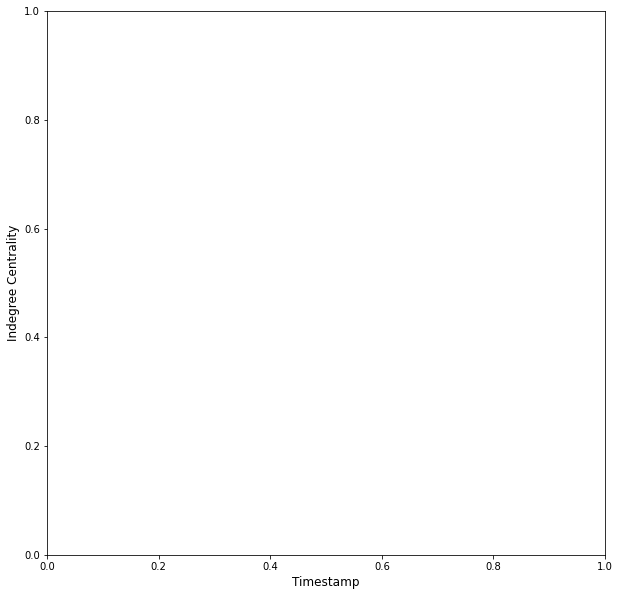

In [304]:
import pandas as pd
import matplotlib.pyplot as plt

# create dataframe
#data = [['1', 9.45e-09, 9.85e-09, 8.33e-09, 6.06e-09, 4.80e-09, 4.08e-09], ['2', 1.30e-08, 1.25e-08, 8.99e-09, 6.25e-09, 4.44e-09, 3.45e-09], ['3', 9.32e-09, 8.60e-09, 5.67e-09, 3.68e-09, 2.53e-09, 1.75e-09]]
#df = pd.DataFrame(data, columns = ['id', '1', '2', '3', '4', '5', '6']).set_index('id')
fig, ax = plt.subplots(figsize=(10, 10))
# transpose and plot
#ax.set_ylabel('Absolute Power (log)',fontsize=12)
#ax.set_xlabel('Frequencies',fontsize=12)
ax.set_ylabel('Indegree Centrality', fontsize=12)
ax.set_xlabel('Timestamp', fontsize=12)
df_final2.T.plot(ax=ax)
#plt.show()

In [ ]:
'''
  #print(top_users)
  #df_final.head()
  edge2count=dict()
  for edge in edges:
    if edge in edge2count:
      edge2count[edge]+=1
    else:
      edge2count[edge]=1
  print("COMPLETE")
  #Create a df with no duplicate indegree and outdegree: Basically number of users in core whom the user RTs or gets RTed by
  l1=[]
  l2=[]
  l3=[]
  l4 = []
  l5=[]
  l6=[]
  #f.write("source"+';'+"target;"+"weight"+'\n')
  for ind in range(df_cent.shape[0]):
    i=0
    o=0
    user = df_cent["index"][ind]
    e = df_cent["eigenvector centrality"][ind]
    ic = df_cent["indegree centrality"][ind]
    oc = df_cent["outdegree centrality"][ind]
    for edge in edge2count:
      if user in edge[0]:
        o+=1
      elif user in edge[1]:
        i+=1
    l1.append(user)
    l2.append(i)
    l3.append(o)
    l4.append(e)
    l5.append(ic)
    l6.append(oc)


  df_cent2 = pd.DataFrame()
  df_cent2["user"] = l1
  df_cent2["indegree"] = l2
  df_cent2["outdegree"] = l3
  df_cent2["eigen centrality"] = l4
  df_cent2["indegree centrality"] = l5
  df_cent2["outdegree centrality"] = l6

  df_cent2["in2out"] = (df_cent2["indegree"]/df_cent2["outdegree"])
  df_cent2.sort_values(["eigen centrality","in2out"],ascending=False,inplace=True)
  df_temp2 = df_cent2.loc[df_cent2["in2out"]!=float('inf')].reset_index()
  print(df_temp2.head())
  '''

In [ ]:
#OLD DATA (NO NEED TO RUN NOW)
#old_path = "drive/My Drive/MSR/ssr_keywords3/"
old_path = "drive/My Drive/MSR/icwsm_analysis/"
pickle.dump(edges,open(old_path+"core_rt_network_caa.pickle","wb"))
#edges = pickle.load(open(path+"core_rt_network_caa.pickle","rb"))

In [ ]:
df_temp2.head()

,index,user,indegree,outdegree,eigen centrality,in2out
0,0,Zebaism,4563,1,0.514309,4563.000000
1,2,IndianN78386157,19,3,0.490868,6.333333
2,1,IshaqSaleji,1,4,0.490868,0.250000
3,3,BalramKhan,1347,2,0.341339,673.500000
4,6,alka1aug,50,1,0.172336,50.000000


In [ ]:
df_temp2.to_csv(old_path+"centrality_values_caa.csv")

In [ ]:
df_hiho.shape

(6, 6)

In [229]:
df_cent.head()

,index,indegree,outdegree,eigenvector centrality,indegree centrality,outdegree centrality,in2out
0,priyankagandhi,4791.0,1.0,0.220018,0.016709,0.000000,4791.000000
1,narendraaggrwal,202.0,46.0,0.212795,0.000705,0.000157,4.391304
2,_AbhiINCIndia,260.0,5.0,0.191035,0.000907,0.000014,52.000000
3,_tanveersheikh,531.0,59.0,0.190532,0.001852,0.000202,9.000000
4,G5MSabir005,200.0,0.0,0.183373,0.000698,0.000000,inf


In [228]:
#Plot CDFs

stats_df_in = get_cdf_data(df_cent,"indegree centrality")
stats_df_out = get_cdf_data(df_cent,"outdegree centrality")
stats_df_eigen = get_cdf_data(df_cent,"eigenvector centrality")
stats_df_out.head()
import plotly.graph_objects as go
from plotly.subplots import make_subplots

trace1 = go.Line(
    x=stats_df_eigen["eigenvector centrality"],
    y=stats_df_eigen["cdf"],
    #orientation="h",
    name="Eigen centrality",
    yaxis='y1',
    marker=dict(
        color='rgb(163,50,50)'
               )
)
trace2 = go.Line(
    x=stats_df_in["indegree centrality"],
    y=stats_df_in["cdf"],
    #orientation="h",
    name="Indegree centrality",
    yaxis='y1',
    marker=dict(
        color='rgb(34,163,0)'
               )
)
trace3 = go.Line(
    x=stats_df_out["outdegree centrality"],
    y=stats_df_out["cdf"],
    #orientation="h",
    name="Outdegree centrality",
    yaxis='y1',
    marker=dict(
        color='rgb(50,50,163)'
               )
)
fig = make_subplots(specs=[[{"secondary_y": False}]])
#fig.add_trace(trace1)
#fig.add_trace(trace2,secondary_y=False)
fig.add_trace(trace1)
fig.add_trace(trace2,secondary_y=False)
fig.add_trace(trace3,secondary_y=False)
#fig.add_trace(trace3,secondary_y=True)
fig['layout'].update(height = 600, width = 1200, xaxis=dict(
      tickangle=-90
    ))
# Set axes titles
fig.update_yaxes(title_text="CDF", secondary_y=False)
fig.update_xaxes(title_text="Centrality values")
fig.update_yaxes(title_text="Number of hashtags and tagline tweets", secondary_y=True)
fig.update_layout({
'plot_bgcolor': 'rgba(0, 0, 0, 0)',
'paper_bgcolor': 'rgba(0, 0, 0, 0)',
})

fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='Grey')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='Grey')
fig.show()

/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning: plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.

  DeprecationWarning,


In [230]:
threshold = 0.001 #caa,budget

In [241]:
import numpy as np

def get_indegree_cent(x):
  return ind_centrality[x]

def get_outdegree_cent(x):
  return out_centrality[x]

def get_bin(x):
  if x>=threshold:
    return 1
  #elif x>0.072:
  #  return 0.5
  else:
    return 0
#df_cent["in2out"] = df_cent["in2out"].replace([np.inf], 500)
#df_cent["indegree centrality"] = df_cent["user"].apply(lambda x:get_indegree_cent(x))
#df_cent["outdegree centrality"] = df_cent["user"].apply(lambda x:get_outdegree_cent(x))
df_cent["bin"] = df_cent["eigenvector centrality"].apply(lambda x:get_bin(x))
df_cent.head()

,index,indegree,outdegree,eigenvector centrality,indegree centrality,outdegree centrality,in2out,bin
0,priyankagandhi,4791.0,1.0,0.220018,0.016709,0.000000,4791.000000,1
1,narendraaggrwal,202.0,46.0,0.212795,0.000705,0.000157,4.391304,1
2,_AbhiINCIndia,260.0,5.0,0.191035,0.000907,0.000014,52.000000,1
3,_tanveersheikh,531.0,59.0,0.190532,0.001852,0.000202,9.000000,1
4,G5MSabir005,200.0,0.0,0.183373,0.000698,0.000000,inf,1


In [ ]:
#df_cent2.to_csv(path+"centralities.csv")
#df_cent2 = pd.read_csv(path+"centralities.csv")
#df_cent2.head(20)

In [231]:
df_cent.loc[df_cent["eigenvector centrality"]>=threshold]
df_cent.sort_values("eigenvector centrality",ascending=False).head(15)

,index,indegree,outdegree,eigenvector centrality,indegree centrality,outdegree centrality,in2out
0,priyankagandhi,4791.0,1.0,0.220018,0.016709,0.000000,4791.000000
1,narendraaggrwal,202.0,46.0,0.212795,0.000705,0.000157,4.391304
2,_AbhiINCIndia,260.0,5.0,0.191035,0.000907,0.000014,52.000000
3,_tanveersheikh,531.0,59.0,0.190532,0.001852,0.000202,9.000000
4,G5MSabir005,200.0,0.0,0.183373,0.000698,0.000000,inf
5,i_am_pravin_inc,206.0,78.0,0.177708,0.000718,0.000269,2.641026
6,livemanish_,270.0,32.0,0.172433,0.000942,0.000108,8.437500
7,DhoteAnup09,119.0,0.0,0.170550,0.000415,0.000000,inf
8,RameshSanapala5,123.0,84.0,0.157428,0.000429,0.000289,1.464286
9,shubhshaurya1,106.0,64.0,0.157053,0.000370,0.000220,1.656250


In [235]:
df_alpha = df_cent.loc[(df_cent["eigenvector centrality"]>=threshold)]
#df_spreaders = df_cent2.loc[(df_cent2["eigen centrality"]>=0.07)&(df_cent2["eigen centrality"]<0.1)]
#df_nobodies = df_cent2.loc[(df_cent2["eigen centrality"]>=0)&(df_cent2["eigen centrality"]<0.07)]
df_nobodies = df_cent.loc[(df_cent["eigenvector centrality"]<threshold)]

In [237]:
from scipy.stats import pearsonr
corr1, _ = pearsonr(df_alpha["outdegree centrality"], df_alpha["eigenvector centrality"])
corr2, _ = pearsonr(df_alpha["indegree centrality"], df_alpha["eigenvector centrality"])

#corr3, _ = pearsonr(df_spreaders["outdegree centrality"], df_spreaders["eigen centrality"])
#corr4, _ = pearsonr(df_spreaders["indegree centrality"], df_spreaders["eigen centrality"])
corr3, _ = pearsonr(df_nobodies["outdegree centrality"], df_nobodies["eigenvector centrality"])
corr4, _ = pearsonr(df_nobodies["indegree centrality"], df_nobodies["eigenvector centrality"])

#corr5, _ = pearsonr(df_spreaders["outdegree centrality"], df_spreaders["eigen centrality"])
#corr6, _ = pearsonr(df_spreaders["indegree centrality"], df_spreaders["eigen centrality"])


In [238]:
print(corr1)
print(corr2)
print(corr3)
print(corr4)
#print(corr5)
#print(corr6)

0.4563417879143051
0.1927781195527244
0.005978790968060452
0.09169697117398537


In [ ]:
#Correlations

df_lilo = df_cent2.loc[(df_cent2["indegree centrality"]<=0.2) & (df_cent2["outdegree centrality"]<=0.2)]  #low indegree low outdegree
df_liho = df_cent2.loc[(df_cent2["indegree centrality"]<=0.2) & (df_cent2["outdegree centrality"]>=0.2)]  #low indegree high outdegree
df_hiho = df_cent2.loc[(df_cent2["indegree centrality"]>=0.2) & (df_cent2["outdegree centrality"]>=0.2)]  #high indegree high outdegree
df_hilo = df_cent2.loc[(df_cent2["indegree centrality"]>=0.2) & (df_cent2["outdegree centrality"]<=0.2)]  #high indegree low outdegree

from scipy.stats import pearsonr
corr1, _ = pearsonr(df_cent2["outdegree centrality"], df_cent2["eigen centrality"])
corr2, _ = pearsonr(df_cent2["indegree centrality"], df_cent2["eigen centrality"])

corr3, _ = pearsonr(df_lilo["outdegree centrality"], df_lilo["eigen centrality"])
corr4, _ = pearsonr(df_lilo["indegree centrality"], df_lilo["eigen centrality"])

corr5, _ = pearsonr(df_liho["outdegree centrality"], df_liho["eigen centrality"])
corr6, _ = pearsonr(df_liho["indegree centrality"], df_liho["eigen centrality"])


corr7, _ = pearsonr(df_hilo["outdegree centrality"], df_hilo["eigen centrality"])
corr8, _ = pearsonr(df_hilo["indegree centrality"], df_hilo["eigen centrality"])


corr9, _ = pearsonr(df_hiho["outdegree centrality"], df_hiho["eigen centrality"])
corr10, _ = pearsonr(df_hiho["indegree centrality"], df_hiho["eigen centrality"])


print('Pearsons correlation: %.3f' % corr1)
print('Pearsons correlation: %.3f' % corr2)
print('Pearsons correlation: %.3f' % corr3)
print('Pearsons correlation: %.3f' % corr4)
print('Pearsons correlation: %.3f' % corr5)
print('Pearsons correlation: %.3f' % corr6)
print('Pearsons correlation: %.3f' % corr7)
print('Pearsons correlation: %.3f' % corr8)
print('Pearsons correlation1: %.3f' % corr9)
print('Pearsons correlation2: %.3f' % corr10)


Pearsons correlation: -0.058
Pearsons correlation: 0.996
Pearsons correlation: -0.017
Pearsons correlation: 0.990
Pearsons correlation: 0.114
Pearsons correlation: 0.990
Pearsons correlation: 0.030
Pearsons correlation: 0.986
Pearsons correlation1: 0.608
Pearsons correlation2: 0.996


In [ ]:
dfrand = df_hiho.reset_index()
dfrand.sort_values("eigen centrality")

,index,Unnamed: 0,user,indegree,outdegree,eigen centrality,in2out,indegree centrality,outdegree centrality,bin
7,54,54,Satya91539128,64,76,0.070552,0.842105,0.212418,0.248366,0.0
6,35,35,blacksheep_119,69,175,0.079444,0.394286,0.228758,0.571895,0.5
5,15,15,kundu_koushani,93,144,0.099409,0.645833,0.307190,0.470588,0.5
4,8,8,ApurvaU21,103,249,0.112789,0.413655,0.339869,0.813725,1.0
3,6,6,suniketroy,113,160,0.123264,0.706250,0.369281,0.522876,1.0
2,5,5,sushfanseg,110,281,0.124504,0.391459,0.362745,0.918301,1.0
1,3,3,Khushi4justice,118,202,0.129706,0.584158,0.388889,0.660131,1.0
0,1,1,MadhumitaroyC,122,181,0.136731,0.674033,0.401961,0.591503,1.0


In [ ]:
df.loc[df["author.username"]=='shubhshaurya1']

In [250]:
df_cent.head(10)

,index,indegree,outdegree,eigenvector centrality,indegree centrality,outdegree centrality,in2out,bin
0,priyankagandhi,4791.0,1.0,0.220018,0.016709,0.000000,4791.000000,1
1,narendraaggrwal,202.0,46.0,0.212795,0.000705,0.000157,4.391304,1
2,_AbhiINCIndia,260.0,5.0,0.191035,0.000907,0.000014,52.000000,1
3,_tanveersheikh,531.0,59.0,0.190532,0.001852,0.000202,9.000000,1
4,G5MSabir005,200.0,0.0,0.183373,0.000698,0.000000,inf,1
5,i_am_pravin_inc,206.0,78.0,0.177708,0.000718,0.000269,2.641026,1
6,livemanish_,270.0,32.0,0.172433,0.000942,0.000108,8.437500,1
7,DhoteAnup09,119.0,0.0,0.170550,0.000415,0.000000,inf,1
8,RameshSanapala5,123.0,84.0,0.157428,0.000429,0.000289,1.464286,1
9,shubhshaurya1,106.0,64.0,0.157053,0.000370,0.000220,1.656250,1


In [242]:
import itertools
#Select the top 10 eigen centrality values and plot the in2out in descending order
df_temp2 = df_cent.sort_values("eigenvector centrality",ascending=False).reset_index()
#df_temp2.head()
#df_temp3 = df_temp2.loc[df_temp2["in2out"]!=500].reset_index()
import plotly.express as px
#plt = px.bar(df_temp2.sort_values("in2out",ascending=True),x="in2out",y="user")
fig = px.scatter(df_temp2, x="eigenvector centrality", y="indegree centrality",color="bin",color_continuous_scale=["green","red"])#px.colors.qualitative.Alphabet)#color_discrete_map={0.:"blue",0.5:"green",1.:"red"})
#fig.update_traces(marker=dict(color='red'))
fig.update_layout({
'plot_bgcolor': 'rgba(0, 0, 0, 0)',
'paper_bgcolor': 'rgba(0, 0, 0, 0)',
})

fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='Grey')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='Grey')
fig.show()

In [268]:
#Find alphas and see their tweets
df_alpha = df_temp2.loc[(df_temp2["eigenvector centrality"]<threshold)&(df_temp2["indegree centrality"]>threshold)]
alphas = df_alpha["index"].unique()
#df_alpha.head()

In [269]:
alphas

array(['Devinder_Sharma', 'upadhyay_harsh1', 'livemint', 'CAChirag',
       'News9Tweets', 'idesibanda', 'CartoonistSan', 'bsindia',
       'ETNOWlive', 'moneycontrolcom', 'TimesNow', 'ShivAroor',
       'prapthi_m', 'MANJULtoons', 'ShyamRangeela', 'Sumitchauhaan',
       'TribalArmy', 'mkstalin', 'TNNavbharat', 'PIB_India',
       'BloombergQuint', 'CNBCTV18News', 'sansad_tv', 'htTweets',
       'rameshsrivats', 'sumanthraman', 'AamAadmiParty', 'IncomeTaxIndia',
       'swati_mishr', 'avinashonly', 'whokumargaurav', 'PIBHindi',
       'sardesairajdeep', 'DDNewslive', 'ANI', 'ZeeBusiness', 'MIB_India',
       'CNBCTV18Live', 'RailMinIndia', 'airnewsalerts', 'AITCofficial',
       'EconomicTimes', 'nsitharamanoffc', 'RJDUttarPradesh', 'FollowCII',
       'DDNewsHindi', 'abhinaymaths', 'WIONews', 'rishibagree',
       'pradip103', 'afficasm', 'ZeeNews', '_YogendraYadav',
       'Tejasvi_Surya', 'CAITIndia', 'business', 'manojkjhadu',
       'amishra77', 'blsanthosh', 'stpiindia', 'arvind

In [273]:
df[(df["author.username"].isin(alphas)) & (df["author.username"]=='News9Tweets')]

,index,id,text,created_at,author_id,in_reply_to_user_id,lang,author,entities,referenced_tweets,media,geo,author.username,retweeted user,edges
11008,598236,1484047053017985027,Writing to #NirmalaSitharaman ahead of #Budget...,2022-01-20,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,NaN,NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
17735,591925,1485525140905820163,"💼💰Continued subsidy support, vital GST revisio...",2022-01-24,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,NaN,NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
24513,585892,1486621750926266369,"Dr Rijo John, a public health expert, advocate...",2022-01-27,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,NaN,NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
214992,536802,1488373821719543808,#BudgetWithNews9 | It's a sobering thought tha...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,"[{""type"":""replied_to"",""id"":""148836624412667084...",NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
225133,541831,1488354562356363267,India is coming out of a protracted lockdown a...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,"[{""type"":""replied_to"",""id"":""148835240244111769...",NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
227294,543501,1488348124943106050,#UnionBudget2022: MoS Finance Pankaj Chaudhar...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,"[{""type"":""replied_to"",""id"":""148834632389220762...",NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
236813,530122,1488386715249438720,#Budget2022 will lay the blueprint for the com...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,"[{""type"":""replied_to"",""id"":""148838512740756684...",NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
239954,525793,1488389516876718080,This #UnionBudget seeks to lay foundation &amp...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,"[{""type"":""replied_to"",""id"":""148838726077317939...",NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
248052,442634,1488421732658475008,#Budget2022: Key highlights.\nLive Updates: ht...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,NaN,NaN,NaN,News9Tweets,None,"(News9Tweets, None)"
262882,427091,1488429408981745664,#BudgetWithNews9 #News9Card #Budget2022 https:...,2022-02-01,633485882,NaN,NaN,"{""id"":""633485882"",""name"":""News9"",""username"":""N...",NaN,"[{""type"":""replied_to"",""id"":""148842173265847500...",NaN,NaN,News9Tweets,None,"(News9Tweets, None)"


In [ ]:
edges = []
for fname in os.listdir(path2):
  df = pd.read_csv(path2+fname)
  for i in range(df.shape[0]):
    if df["retweeted user"][i]!="None" and df["retweeted user"][i] in username_l:
      edge = (df["user"][i],df["retweeted user"][i])
      edges.append(edge)
print("COMPLETE")

NameError: ignored

In [ ]:
path2 = path+"Tweet Data Complete Cleaned/"

In [ ]:
username_l=[]
for fname in os.listdir(path):
  if (".correct3" in fname or ".correct4" in fname or ".correct5" in fname or ".correct6" in fname or ".correct7" in fname
  or ".correct8" in fname or ".correct9" in fname or ".correct10" in fname or ".correct11" in fname or ".correct12" in fname or ".correct_all" in fname
  or ".correct_JunNov21" in fname) and "_user" not in fname:
    username = fname.split(".")[0]
    username_l.append(username)
username_l = list(set(username_l))

In [ ]:
c=0
user = "nilotpalm3"
#user = "SandyDutta11"
for edge in edge2count:
  if edge[1] == user:
   c+=1
print(c)
#edge2count[("_ADITICHOURASIA","HashiTammy")]
#edge2count[("_ADITICHOURASIA","nilotpalm3")]
#edge2count[("Khushi4justice","SSRkaFan")]

In [ ]:
s=set()
for edge in edges:
  s.add(edge[0])
  s.add(edge[1])
len(s)

"nilotpalm6" in s

In [ ]:
!pip3 install pyvis

# Random experiment to check the old network against Soham's n/w

In [ ]:
path2 = 'drive/My Drive/MSR/ssr_keywords3/all_tweets_in_one_file_complete/'
#path2 = path
df2 = pd.read_csv(path2+"all_tweets.csv")

In [ ]:
df_temp = df2.loc[df2["user"]=="_ADITICHOURASIA"]["text"].reset_index()

In [ ]:
df_temp.loc[df_temp["text"].str.contains("HashiTammy")]

In [ ]:
path3 = 'drive/My Drive/MSR/ssr_keywords3/Tweet Data Complete Cleaned/'

df4 = pd.read_csv(path3+"_ADITICHOURASIA.all_tweet_data_clean.csv")

In [ ]:
df4.loc[df4["text"].str.contains("HashiTammy")]